<a href="https://colab.research.google.com/github/jarodchristiansen/PythonProjects/blob/master/Dog_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import glob
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from google.colab import output
import cv2

In [ ]:
!unzip Dog_Set.zip
#output.clear()

In [ ]:
import os
for img in glob.glob(image_path):
  #if img == 'LLD-logo-files/cheapbats.png':
  #  os.remove(img)
  print(img)

NameError: ignored

In [ ]:
image_path = 'Dog_Set/*'
images_array = []


for image in glob.glob(image_path)[0:3001]:
  img = Image.open(image)
  img = Image.Image.resize(img, (240,240))
  img = np.asarray(img)
  image_flipped = cv2.flip(img, 1)
  images_array.append(img)
  images_array.append(image_flipped)

  
  

images_array = np.asarray(images_array)
X_train = images_array.astype('float32')
X_train = (X_train - 127.5) /127.5

In [ ]:
limage_path = 'LLD-logo-files/*'
# example of progressively loading images from file
from keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(rescale=1. / 255)
itr = train_datagen.flow_from_directory(
'.', classes=['Dog_Set'],
target_size=(240, 240),
batch_size=3000)
images_array  = np.asarray(itr.next())

Using TensorFlow backend.


Found 0 images belonging to 1 classes.


NameError: ignored

In [ ]:
X_train[0]

NameError: ignored

In [ ]:
from keras.models import Sequential, Model
from keras.layers import *
from keras.layers.advanced_activations import LeakyReLU

Using TensorFlow backend.


In [ ]:
generator = Sequential()
generator.add(Dense(128*60*60, input_dim=100))
generator.add(LeakyReLU(alpha=0.2))
generator.add(BatchNormalization())
generator.add(Reshape((60, 60,128)))
generator.add(UpSampling2D())
generator.add(Convolution2D(128, 5,5, border_mode='same'))
generator.add(LeakyReLU(alpha=0.2))
generator.add(BatchNormalization())
generator.add(Convolution2D(56, 3,3, border_mode='same'))
generator.add(LeakyReLU(alpha=0.2))
generator.add(BatchNormalization())
generator.add(UpSampling2D())
generator.add(Convolution2D(3, 5,5, border_mode='same', activation='tanh'))
generator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 460800)            46540800  
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 460800)            0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 460800)            1843200   
_________________________________________________________________
reshape_1 (Reshape)          (None, 60, 60, 128)       0         
_________________________________________________________________
up_sampling2d_1 (UpSampling2 (None, 120, 120, 128)     0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 120, 120, 128)     409728    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 120, 120, 128)    

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (5, 5), padding="same")`
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(56, (3, 3), padding="same")`
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(3, (5, 5), activation="tanh", padding="same")`
  


In [ ]:
discriminator = Sequential()

discriminator.add(Convolution2D(124,5,5, input_shape=(240,240,3), subsample=(2,2), border_mode='same'))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dropout(0.4))
discriminator.add(Convolution2D(124,5,5, subsample=(2,2), border_mode='same'))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dropout(0.4))
discriminator.add(Flatten())
discriminator.add(Dense(1, activation='sigmoid'))

discriminator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 120, 120, 124)     9424      
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 120, 120, 124)     0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 120, 120, 124)     0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 60, 60, 124)       384524    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 60, 60, 124)       0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 60, 60, 124)       0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 446400)           

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(124, (5, 5), input_shape=(240, 240,..., strides=(2, 2), padding="same")`
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(124, (5, 5), strides=(2, 2), padding="same")`
  


In [ ]:
from tensorflow.keras.optimizers import Adam
adam=Adam(lr=0.001, beta_1=0.5)

In [ ]:
discriminator.trainable = True
discriminator.compile(loss='binary_crossentropy', optimizer=adam)

In [ ]:
generator.compile(loss='binary_crossentropy', optimizer=adam)

In [ ]:
ganInput = Input(shape=(100,))

x = generator(ganInput)
discriminator.trainable = False
ganOutput = discriminator(x)


gan = Model(input=ganInput, output=ganOutput)
gan.compile(loss='binary_crossentropy', optimizer=adam)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("se...)`
  


In [ ]:
generator.load_model('Dog_Gen_V1.h5')
generator.trainable = True
generator.compile(loss='binary_crossentropy', optimizer=adam)


gan.load_model('Dog_GAN_V1.h5')
gan.compile(loss='binary_crossentropy', optimizer=adam)

AttributeError: ignored

In [ ]:
!mkdir GAN_output

In [ ]:
def train(num_epochs, batch_size):
  batch_count = X_train.shape[0] // batch_size
  print('Batch count: {}'.format(batch_count))

  for epoch in range(num_epochs):
    print('Epoch: {}'.format(epoch))
	
    for batch in range(batch_count):
        noise_input = np.random.rand(batch_size, 100)
        fake_images = generator.predict(noise_input, batch_size=batch_size)
            
        image_batch = X_train[np.random.randint(0,X_train.shape[0], size=batch_size)]
        images = np.concatenate([fake_images, image_batch])
        labels = [0.95]*batch_size + [0.05]*batch_size
        discriminator.trainable = True

        d = discriminator.fit(images, labels, verbose=0)


        y_generator = [0.05] * batch_size
        discriminator.trainable = False
        g = gan.fit(noise_input, y_generator, verbose=0)

        input_g = np.random.rand(1,100)
        preds = (generator.predict(input_g)+1.0)/2.0

        if epoch % 200 == 0:
         for pred in range(preds.shape[0]):
            plt.imshow(preds[pred])    
            if epoch%1000 == 0:
              plt.savefig('GAN_output/epoch{}.jpg'.format(str(epoch)), dpi=250)
            plt.show()

In [ ]:
train(50000, 20)

In [ ]:
!zip -r ./GAN_output_V1.zip ./GAN_output/

  adding: GAN_output/ (stored 0%)
  adding: GAN_output/epoch0.jpg (deflated 9%)
  adding: GAN_output/epoch100.jpg (deflated 7%)
  adding: GAN_output/epoch200.jpg (deflated 5%)
  adding: GAN_output/epoch50.jpg (deflated 6%)


In [ ]:
gan.save('Dog_GAN_470E.h5')
generator.save('Dog_Gen_470E.h5')

/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:165: UserWarning: TensorFlow optimizers do not make it possible to access optimizer attributes or optimizer state after instantiation. As a result, we cannot save the optimizer as part of the model save file.You will have to compile your model again after loading it. Prefer using a Keras optimizer instead (see keras.io/optimizers).
  'TensorFlow optimizers do not '


In [ ]:
generator.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 460800)            46540800  
_________________________________________________________________
leaky_re_lu_23 (LeakyReLU)   (None, 460800)            0         
_________________________________________________________________
batch_normalization_13 (Batc (None, 460800)            1843200   
_________________________________________________________________
reshape_5 (Reshape)          (None, 60, 60, 128)       0         
_________________________________________________________________
up_sampling2d_9 (UpSampling2 (None, 120, 120, 128)     0         
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 120, 120, 128)     409728    
_________________________________________________________________
leaky_re_lu_24 (LeakyReLU)   (None, 120, 120, 128)   

In [ ]:
del generator
del gan

NameError: ignored

In [ ]:
del discriminator

NameError: ignored

In [ ]:
generator.summary()

NameError: ignored

In [ ]:
discriminator.summary()

NameError: ignored

#the below code is an example on loading the finished generator model and using it to create images on demand. This has not yet been tested on the model and will take adjustment

Batch count: 31
Epoch: 0


/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


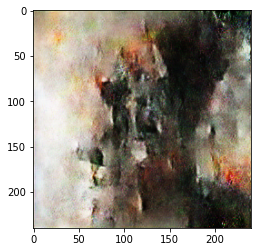

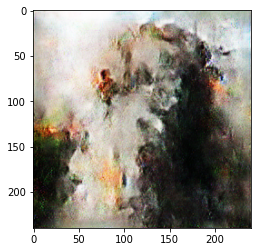

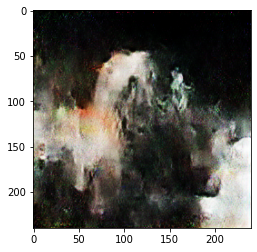

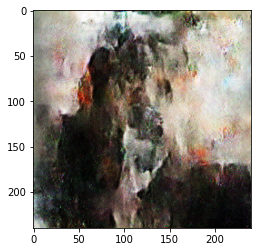

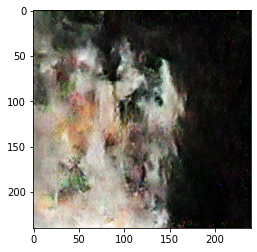

...

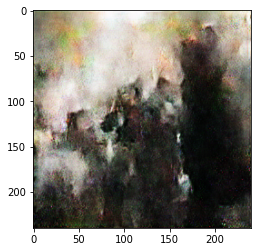

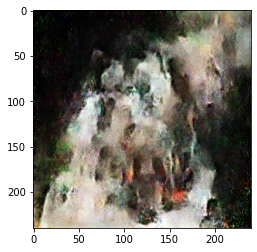

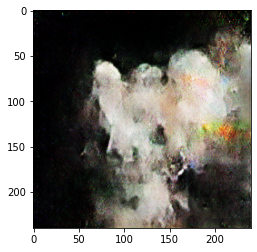

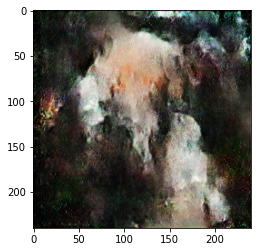

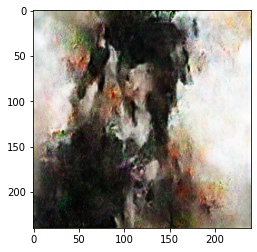

Epoch: 1
Epoch: 2
Epoch: 3
Epoch: 4
Epoch: 5
Epoch: 6
Epoch: 7
Epoch: 8
Epoch: 9
Epoch: 10
Epoch: 11
Epoch: 12
Epoch: 13
Epoch: 14
Epoch: 15
Epoch: 16
Epoch: 17
Epoch: 18
Epoch: 19
Epoch: 20
Epoch: 21
Epoch: 22
Epoch: 23
Epoch: 24
Epoch: 25
Epoch: 26
Epoch: 27
Epoch: 28
Epoch: 29
Epoch: 30
Epoch: 31
Epoch: 32
Epoch: 33
Epoch: 34
Epoch: 35
Epoch: 36
Epoch: 37
Epoch: 38
Epoch: 39
Epoch: 40
Epoch: 41
Epoch: 42
Epoch: 43
Epoch: 44
Epoch: 45
Epoch: 46
Epoch: 47
Epoch: 48
Epoch: 49
Epoch: 50


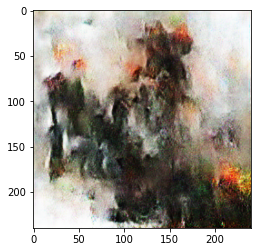

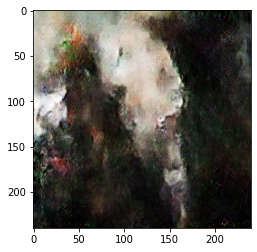

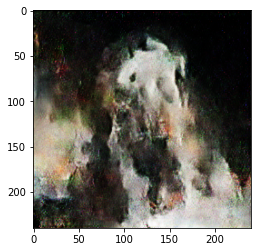

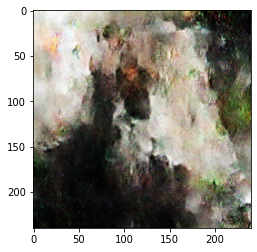

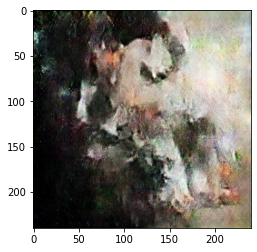

...

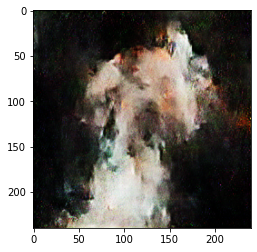

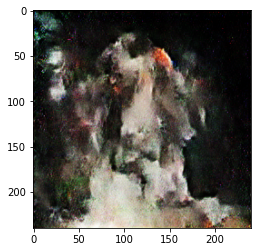

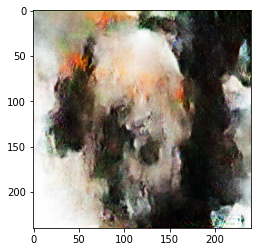

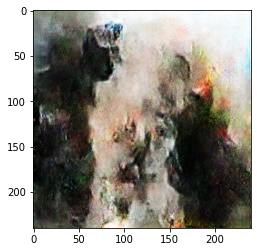

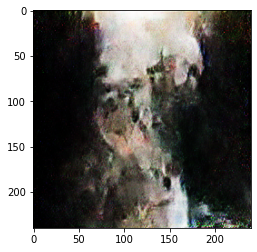

Epoch: 51
Epoch: 52
Epoch: 53
Epoch: 54
Epoch: 55
Epoch: 56
Epoch: 57
Epoch: 58
Epoch: 59
Epoch: 60
Epoch: 61
Epoch: 62
Epoch: 63
Epoch: 64
Epoch: 65
Epoch: 66
Epoch: 67
Epoch: 68
Epoch: 69
Epoch: 70
Epoch: 71
Epoch: 72
Epoch: 73
Epoch: 74
Epoch: 75
Epoch: 76
Epoch: 77
Epoch: 78
Epoch: 79
Epoch: 80
Epoch: 81
Epoch: 82
Epoch: 83
Epoch: 84
Epoch: 85
Epoch: 86
Epoch: 87
Epoch: 88
Epoch: 89
Epoch: 90
Epoch: 91
Epoch: 92
Epoch: 93
Epoch: 94
Epoch: 95
Epoch: 96
Epoch: 97
Epoch: 98
Epoch: 99
Epoch: 100


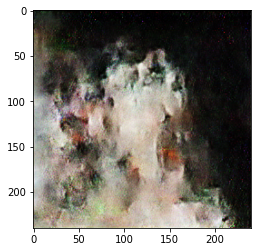

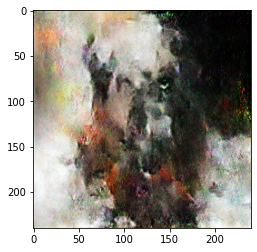

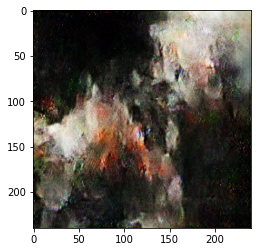

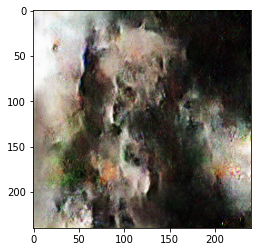

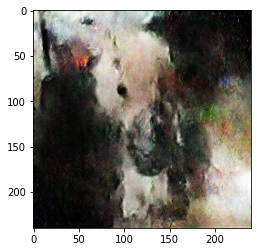

...

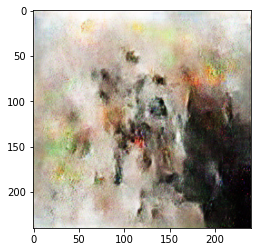

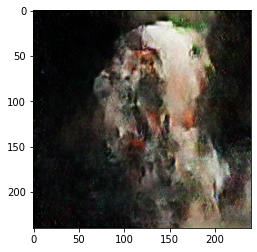

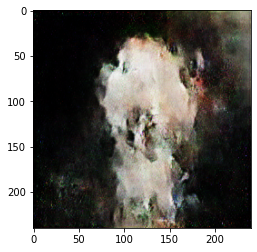

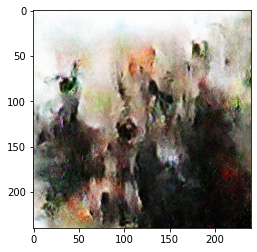

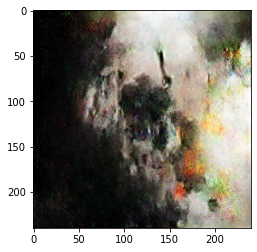

Epoch: 101
Epoch: 102
Epoch: 103
Epoch: 104
Epoch: 105
Epoch: 106
Epoch: 107
Epoch: 108
Epoch: 109
Epoch: 110
Epoch: 111
Epoch: 112
Epoch: 113
Epoch: 114
Epoch: 115
Epoch: 116
Epoch: 117
Epoch: 118
Epoch: 119
Epoch: 120
Epoch: 121
Epoch: 122
Epoch: 123
Epoch: 124
Epoch: 125
Epoch: 126
Epoch: 127
Epoch: 128
Epoch: 129
Epoch: 130
Epoch: 131
Epoch: 132
Epoch: 133
Epoch: 134
Epoch: 135
Epoch: 136
Epoch: 137
Epoch: 138
Epoch: 139
Epoch: 140
Epoch: 141
Epoch: 142
Epoch: 143
Epoch: 144
Epoch: 145
Epoch: 146
Epoch: 147
Epoch: 148
Epoch: 149
Epoch: 150


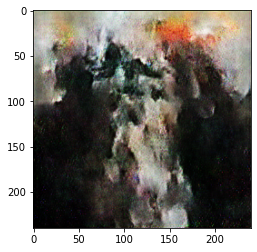

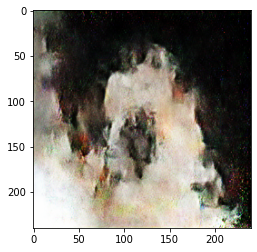

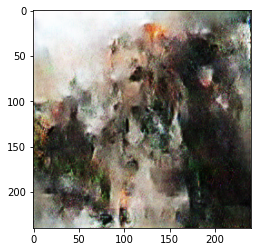

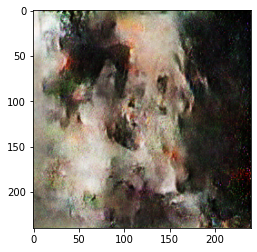

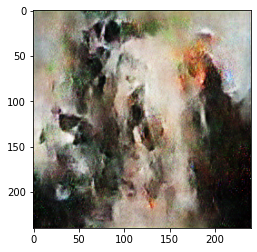

...

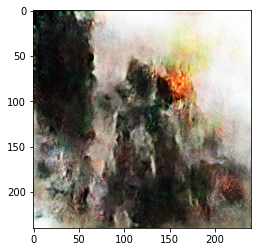

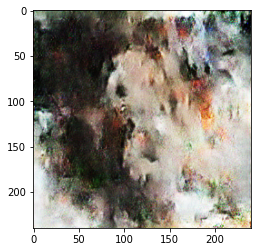

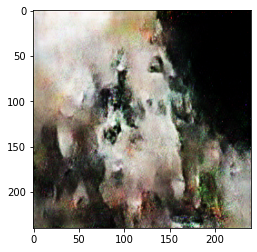

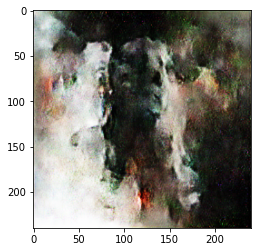

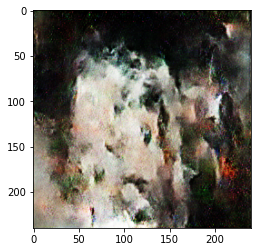

Epoch: 151
Epoch: 152
Epoch: 153
Epoch: 154
Epoch: 155
Epoch: 156
Epoch: 157
Epoch: 158
Epoch: 159
Epoch: 160
Epoch: 161
Epoch: 162
Epoch: 163
Epoch: 164
Epoch: 165
Epoch: 166
Epoch: 167
Epoch: 168
Epoch: 169
Epoch: 170
Epoch: 171
Epoch: 172
Epoch: 173
Epoch: 174
Epoch: 175
Epoch: 176
Epoch: 177
Epoch: 178
Epoch: 179
Epoch: 180
Epoch: 181
Epoch: 182
Epoch: 183
Epoch: 184
Epoch: 185
Epoch: 186
Epoch: 187
Epoch: 188
Epoch: 189
Epoch: 190
Epoch: 191
Epoch: 192
Epoch: 193
Epoch: 194
Epoch: 195
Epoch: 196
Epoch: 197
Epoch: 198
Epoch: 199
Epoch: 200


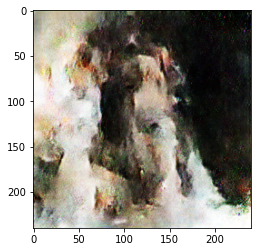

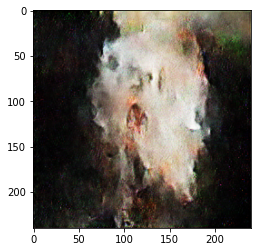

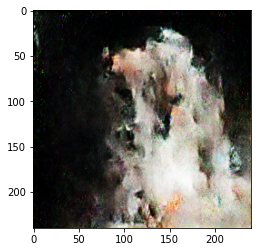

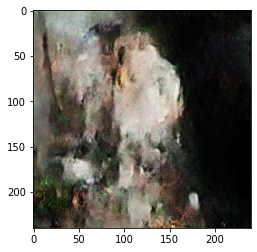

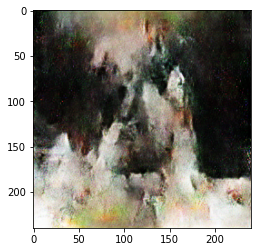

...

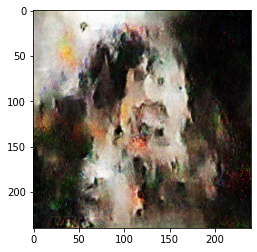

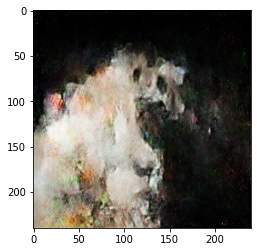

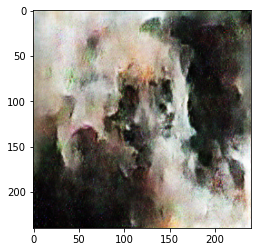

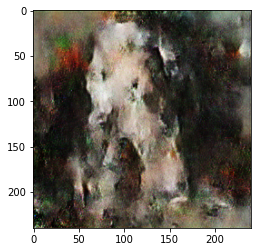

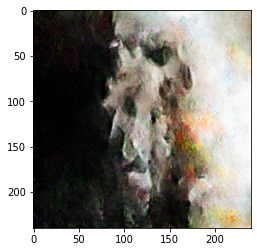

Epoch: 201
Epoch: 202
Epoch: 203
Epoch: 204
Epoch: 205
Epoch: 206
Epoch: 207
Epoch: 208
Epoch: 209
Epoch: 210
Epoch: 211
Epoch: 212
Epoch: 213
Epoch: 214
Epoch: 215
Epoch: 216
Epoch: 217
Epoch: 218
Epoch: 219
Epoch: 220
Epoch: 221
Epoch: 222
Epoch: 223
Epoch: 224
Epoch: 225
Epoch: 226
Epoch: 227
Epoch: 228
Epoch: 229
Epoch: 230
Epoch: 231
Epoch: 232
Epoch: 233
Epoch: 234
Epoch: 235
Epoch: 236
Epoch: 237
Epoch: 238
Epoch: 239
Epoch: 240
Epoch: 241
Epoch: 242
Epoch: 243
Epoch: 244
Epoch: 245
Epoch: 246
Epoch: 247
Epoch: 248
Epoch: 249
Epoch: 250


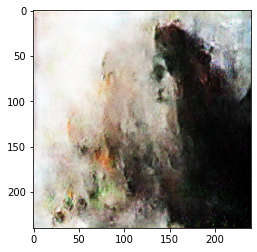

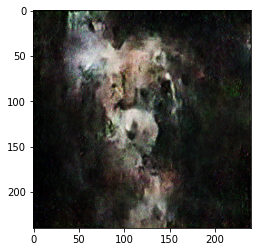

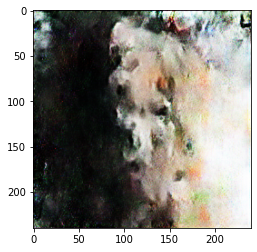

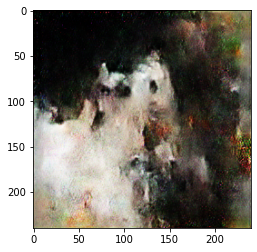

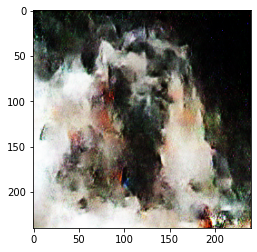

...

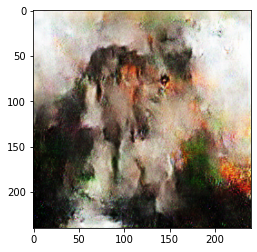

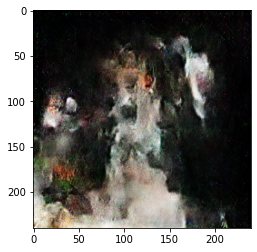

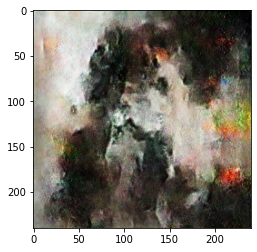

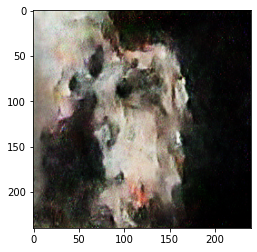

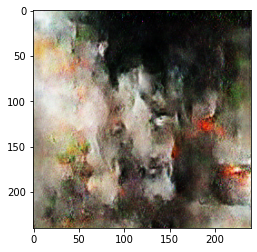

Epoch: 251
Epoch: 252
Epoch: 253
Epoch: 254
Epoch: 255
Epoch: 256
Epoch: 257
Epoch: 258
Epoch: 259
Epoch: 260
Epoch: 261
Epoch: 262
Epoch: 263
Epoch: 264
Epoch: 265
Epoch: 266
Epoch: 267
Epoch: 268
Epoch: 269
Epoch: 270
Epoch: 271
Epoch: 272
Epoch: 273
Epoch: 274
Epoch: 275
Epoch: 276
Epoch: 277
Epoch: 278
Epoch: 279
Epoch: 280
Epoch: 281
Epoch: 282
Epoch: 283
Epoch: 284
Epoch: 285
Epoch: 286
Epoch: 287
Epoch: 288
Epoch: 289
Epoch: 290
Epoch: 291
Epoch: 292
Epoch: 293
Epoch: 294
Epoch: 295
Epoch: 296
Epoch: 297
Epoch: 298
Epoch: 299
Epoch: 300


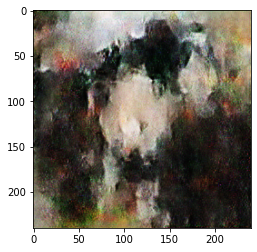

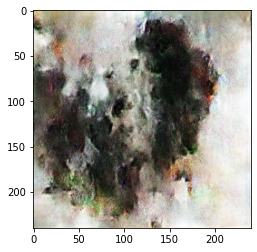

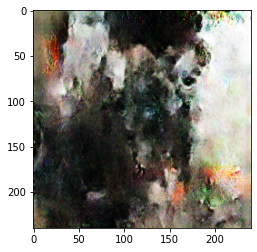

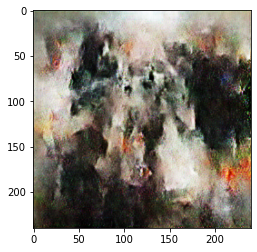

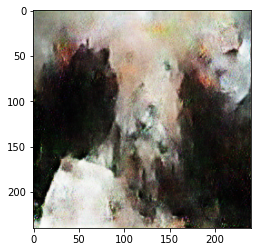

...

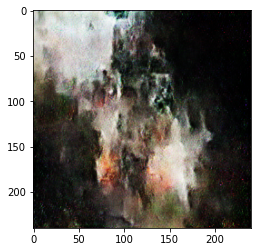

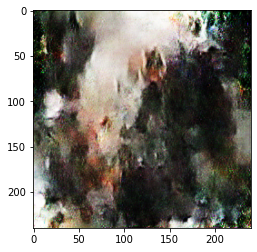

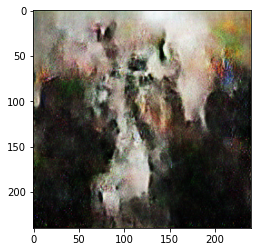

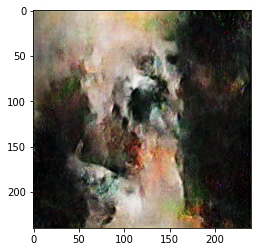

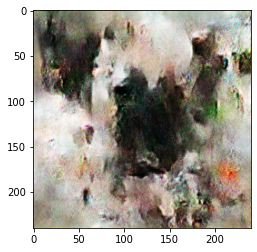

Epoch: 301
Epoch: 302
Epoch: 303
Epoch: 304
Epoch: 305
Epoch: 306
Epoch: 307
Epoch: 308
Epoch: 309
Epoch: 310
Epoch: 311
Epoch: 312
Epoch: 313
Epoch: 314
Epoch: 315
Epoch: 316
Epoch: 317
Epoch: 318
Epoch: 319
Epoch: 320
Epoch: 321
Epoch: 322
Epoch: 323
Epoch: 324
Epoch: 325
Epoch: 326
Epoch: 327
Epoch: 328
Epoch: 329
Epoch: 330
Epoch: 331
Epoch: 332
Epoch: 333
Epoch: 334
Epoch: 335
Epoch: 336
Epoch: 337
Epoch: 338


In [ ]:
# example of loading the generator model and generating images
from keras.models import load_model
from numpy.random import randn
from matplotlib import pyplot
 
# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
	# generate points in the latent space
	x_input = randn(latent_dim * n_samples)
	# reshape into a batch of inputs for the network
	x_input = x_input.reshape(n_samples, latent_dim)
	return x_input
 
# plot the generated images
def create_plot(examples, n):
	# plot images
	for i in range(n * n):
		# define subplot
		pyplot.subplot(n, n, 1 + i)
		# turn off axis
		pyplot.axis('off')
		# plot raw pixel data
		pyplot.imshow(examples[i, :, :])
	pyplot.show()
 
# load model
model = load_model('generator_model_200.h5')
# generate images
latent_points = generate_latent_points(100, 100)
# generate images
X = model.predict(latent_points)
# scale from [-1,1] to [0,1]
X = (X + 1) / 2.0
# plot the result
create_plot(X, 10)

In [ ]:
!zip -r GAN_output.zip GAN_output



from google.colab import files
files.download("GAN_output.zip")

  adding: GAN_output/ (stored 0%)
  adding: GAN_output/.ipynb_checkpoints/ (stored 0%)
  adding: GAN_output/Dog_Img_GAN_6000.h5 (deflated 7%)
  adding: GAN_output/epoch3000.jpg (deflated 5%)
  adding: GAN_output/epoch0.jpg (deflated 7%)
  adding: GAN_output/epoch6000.jpg (deflated 5%)


----------------------------------------
Exception happened during processing of request from ('::ffff:127.0.0.1', 45442, 0, 0)
Traceback (most recent call last):
  File "/usr/lib/python3.6/socketserver.py", line 320, in _handle_request_noblock
    self.process_request(request, client_address)
  File "/usr/lib/python3.6/socketserver.py", line 351, in process_request
    self.finish_request(request, client_address)
  File "/usr/lib/python3.6/socketserver.py", line 364, in finish_request
    self.RequestHandlerClass(request, client_address, self)
  File "/usr/lib/python3.6/socketserver.py", line 724, in __init__
    self.handle()
  File "/usr/lib/python3.6/http/server.py", line 418, in handle
    self.handle_one_request()
  File "/usr/lib/python3.6/http/server.py", line 406, in handle_one_request
    method()
  File "/usr/lib/python3.6/http/server.py", line 639, in do_GET
    self.copyfile(f, self.wfile)
  File "/usr/lib/python3.6/http/server.py", line 800, in copyfile
    shutil.copyfil